# Exploratory Data Analysis of Spotify tracks!

### Hope these tracks can be popular ...

In [1]:
import pandas as pd
from pandas_profiling import ProfileReport
import altair as alt
from sklearn.model_selection import train_test_split

#### 1. Formulate our question
> We want to predict the popularity of a song, given various features such as genre, duration, energy, tempo and acousticness. <br>
> Can our raw data do this for us?

#### 2. Read in the data 

In [2]:
audio = pd.read_csv('../data/raw/audio_features.csv')

##### 2.1 Split train set and test set

In [3]:
audio_train, audio_test = train_test_split(audio, test_size=0.2, random_state=123)

In [4]:
audio_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23602 entries, 9624 to 19966
Data columns (total 22 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   song_id                    23602 non-null  object 
 1   performer                  23602 non-null  object 
 2   song                       23602 non-null  object 
 3   spotify_genre              22312 non-null  object 
 4   spotify_track_id           19526 non-null  object 
 5   spotify_track_preview_url  11591 non-null  object 
 6   spotify_track_duration_ms  19526 non-null  float64
 7   spotify_track_explicit     19526 non-null  object 
 8   spotify_track_album        19521 non-null  object 
 9   danceability               19473 non-null  float64
 10  energy                     19473 non-null  float64
 11  key                        19473 non-null  float64
 12  loudness                   19473 non-null  float64
 13  mode                       19473 non-null  

#### 3. Look at the Top and the Bottom of our Data

In [5]:
audio_train.head()

,song_id,performer,song,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
9624,Here's A HeartThe Diplomats,The Diplomats,Here's A Heart,"['gangster rap', 'hardcore hip hop', 'harlem h...",39xymLsE59O6HtMtqMhb7A,https://p.scdn.co/mp3-preview/9a96cf7978baef30...,155200.0,False,Ace's Golden Age of American Hits Vol 1,0.560,...,-7.113,1.0,0.0380,0.5430,0.000000,0.6380,0.555,81.824,3.0,0.0
5431,DigIncubus,Incubus,Dig,"['alternative metal', 'alternative rock', 'fun...",5wvYib82q05wiNjLElD8GJ,https://p.scdn.co/mp3-preview/869c0cf3f8e04da5...,257253.0,False,Light Grenades,0.450,...,-4.739,1.0,0.0386,0.0293,0.000000,0.1160,0.463,77.577,4.0,63.0
11066,I Like Dreamin'Kenny Nolan,Kenny Nolan,I Like Dreamin',['bubblegum pop'],4wlRO5dyyO7jYrzs2PltV8,https://p.scdn.co/mp3-preview/d9006c9b1b11f409...,221560.0,False,All-Time Greatest Performances,0.626,...,-14.203,0.0,0.0394,0.9530,0.007690,0.1030,0.253,123.911,4.0,38.0
1241,All You Need Is LoveThe Beatles,The Beatles,All You Need Is Love,"['british invasion', 'merseybeat', 'psychedeli...",68BTFws92cRztMS1oQ7Ewj,NaN,230386.0,False,Magical Mystery Tour (Remastered),0.400,...,-7.768,1.0,0.0295,0.3460,0.000031,0.1550,0.653,103.436,4.0,69.0
6453,"Eat It""Weird Al"" Yankovic","""Weird Al"" Yankovic",Eat It,"['antiviral pop', 'comedy rock', 'comic', 'par...",0WuYuWhLws8VahMy2zLLRJ,https://p.scdn.co/mp3-preview/5b9843b163d62ce6...,200626.0,False,"The Essential ""Weird Al"" Yankovic",0.767,...,-8.548,1.0,0.0766,0.0866,0.000000,0.0684,0.858,147.423,4.0,46.0


In [8]:
audio_train.tail()

,song_id,performer,song,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
28636,XOJohn Mayer,John Mayer,XO,"['neo mellow', 'pop', 'pop rock', 'singer-song...",7cpCU3Denug5NGZsSpQl8v,https://p.scdn.co/mp3-preview/ae749156ad44a169...,213626.0,False,XO,0.431,...,-9.753,1.0,0.0288,0.74900,0.0,0.211,0.353,173.670,4.0,73.0
17730,Nobody But YouKenny Loggins With Jim Messina,Kenny Loggins With Jim Messina,Nobody But You,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28030,Who Do You Think You AreThe Shindogs,The Shindogs,Who Do You Think You Are,[],3DBdTT9nwUOw4ENzumkyWi,https://p.scdn.co/mp3-preview/9e2488051b846598...,148813.0,False,Ain't It Hard! Garage & Psych From Viva Records,0.651,...,-7.693,1.0,0.0306,0.33800,0.0,0.229,0.937,132.727,4.0,2.0
15725,LuanneForeigner,Foreigner,Luanne,"['album rock', 'classic rock', 'hard rock', 'm...",0t7szxjCNe2CCnlmIihHwS,https://p.scdn.co/mp3-preview/5ba2baff8224885c...,207493.0,False,4 (Expanded),0.600,...,-5.362,1.0,0.0411,0.00295,0.0,0.120,0.784,141.133,4.0,38.0
19966,Rich As HellYoungBoy Never Broke Again,YoungBoy Never Broke Again,Rich As Hell,"['baton rouge rap', 'trap']",5A6tFAdihqILHJrWuR6wD4,https://p.scdn.co/mp3-preview/5f625ea5748dc9a6...,215327.0,True,AI YoungBoy 2,0.874,...,-5.256,1.0,0.4410,0.03820,0.0,0.215,0.228,154.040,4.0,71.0


#### 4. Check our “n”s

> To have a general understanding of our data, we'll use pandas profiling from here. <br>
> The script that generate the eda report of a `html` version is in `src`. <br>
> The `html` version eda report is [here](https://github.com/scarlqq/DSCI_522_Spotify_Track_Popularity_Predictor/blob/qq/eda/eda_report.html).

In [9]:
# profile = ProfileReport(audio_train, title="Pandas Profiling Report")  #, minimal=True)
# profile.to_notebook_iframe()

#### 5. Make a plot
> The distribution and the correlation of the data are in the eda report. <br>
> We'll explore the relationship between `spotify_track_popularity` and the features which have at least weak correlation (pearson's r > 0.1).

In [10]:
# List out the correlated features
imp_features = list(audio_train.corr().query('spotify_track_popularity > 0.1').sort_values(by=['spotify_track_popularity']).index)
imp_features.remove('spotify_track_popularity')
imp_features.remove('time_signature')
imp_features

['energy',
 'spotify_track_duration_ms',
 'danceability',
 'speechiness',
 'loudness']

> Notice that we remove `time_signature` since it is actually a categorical feature. We may have another plot for this one.

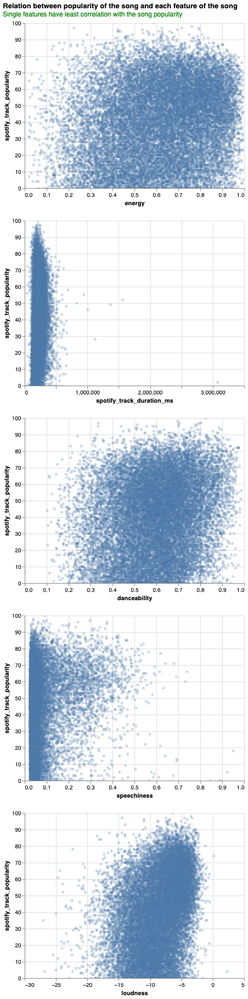

In [14]:
# The scatter plot for numeric features
alt.renderers.enable('mimetype')
alt.data_transformers.disable_max_rows()

rela = alt.Chart(audio_train).mark_point(opacity=0.3, size=10).encode(
     alt.X(alt.repeat('row'), type='quantitative',
          scale=alt.Scale(zero=False)),
     alt.Y('spotify_track_popularity', type='quantitative',
          scale=alt.Scale(zero=False)),
     tooltip='song'
).repeat(
    row=imp_features
).properties(
    title={
      "text": ["Relation between popularity of the song and each feature of the song"], 
      "subtitle": ["Single features have least correlation with the song popularity"],
      "color": "black",
      "subtitleColor": "green"
    }
).interactive()

rela

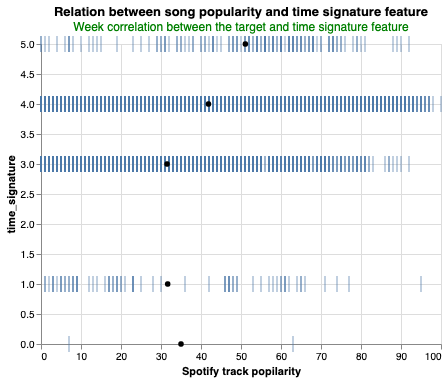

In [32]:
# The tick plot for categorical features


tick = alt.Chart(audio_train).mark_tick().encode(
    alt.Y('time_signature'),
    alt.X('spotify_track_popularity', scale = alt.Scale(zero=False), title = "Spotify track popilarity"),
)

tick_plot = (tick + tick.mark_point(
    filled=True, color='black'
    ).encode(
        x=alt.X('spotify_track_popularity',
                aggregate='mean',
                title = "Spotify track popilarity"
               )
    )
).properties(
    title={
        "text": ["Relation between song popularity and time signature feature"], 
        "subtitle": ["Week correlation between the target and time signature feature"],
        "subtitleColor": "green"
    }
)


# Show the plot
tick_plot

In [13]:
audio_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23602 entries, 9624 to 19966
Data columns (total 22 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   song_id                    23602 non-null  object 
 1   performer                  23602 non-null  object 
 2   song                       23602 non-null  object 
 3   spotify_genre              22312 non-null  object 
 4   spotify_track_id           19526 non-null  object 
 5   spotify_track_preview_url  11591 non-null  object 
 6   spotify_track_duration_ms  19526 non-null  float64
 7   spotify_track_explicit     19526 non-null  object 
 8   spotify_track_album        19521 non-null  object 
 9   danceability               19473 non-null  float64
 10  energy                     19473 non-null  float64
 11  key                        19473 non-null  float64
 12  loudness                   19473 non-null  float64
 13  mode                       19473 non-null  

In [26]:
obj_features = audio_train.select_dtypes(include='object').columns.to_list()
obj_unique = dict()
for feat in obj_features:
    obj_unique[feat] = len(audio_train[feat].unique())
pd.DataFrame(obj_unique, index = ['unique_class_number']).T

,unique_class_number
song_id,23526
performer,8710
song,20044
spotify_genre,3131
spotify_track_id,19384
spotify_track_preview_url,11515
spotify_track_explicit,3
spotify_track_album,11398



-  We found that `energy`, `spotify_track_duration_ms`, `danceability`, `speechiness`, `loudness` have at least weak correlation to our target. Among them, `danceability` and `loudness` seems have a positive relationship with the target. We may probably pay more attention to these features after in model building.
-  The column `spotify_track_preview_url` have more than 10,000 missing values, we may probably drop the column when we build the model.
-  For the object features, we found `song_id`, `song`, `spotify_track_id`, `spotify_track_preview_url`, `spotify_track_album` have more than 10,000 unique values. It will difficult for us to use them as categorical features in the model so we may probably drop them or transform them, e.g. for `song`, the tile of the song, we may probably use count vectorizer to grab the information from this column.

#### 6. Try the Easy Solution First

> Before the machine learning models, let's build up a simple linear model using these features first.

In [11]:

from sklearn.linear_model import LinearRegression


reg_col = list(audio_train.corr().query('spotify_track_popularity > 0.1').sort_values(by=['spotify_track_popularity']).index)
reg_df = audio_train[reg_col]
reg_df = reg_df.dropna()

reg_X = reg_df[imp_features]
reg_y = reg_df['spotify_track_popularity']
reg = LinearRegression().fit(reg_X, reg_y)
reg.score(reg_X, reg_y)

0.20066395205505516

In [12]:
reg.coef_

array([-2.01133866e+01,  5.79420796e-05,  1.63113602e+01,  3.65997317e+01,
        2.69234949e+00])

#### 7.Follow-up Questions
-  Do we have the right data?
> The data can be matched with external data, and it has enough features and observations for us to answer the question. 
-  Do we need other data?
> This data may be enough. <br>
> But we may need to drop some columns and transform some columns before we build the predictive model.
-  Do we have the right question?
> We found that linear regression did not perform well on our selected features, that can be caused by distribution of the data as well as the method of the model. We can fix this by transforming the columns and changing the model e.g. ridge.